# Input features
Distintas opciones de input features


TODO
+ add padding at start to avoid errors if onset in first frame

LITERATURE
+ Logf-STFT
+ Mel spectrogram
+ Multi-band onset strength / First order differential-spectrogram
+ Differential spectrogram --> NMF

Maybe MFCCs? (even more reduced)

In [4]:
import sys
sys.path.append('../../hvo_sequence/')

from hvo_sequence.hvo_seq import HVO_Sequence

import os
import numpy as np
import pickle
import pandas as pd

import librosa


### Load processed dataset and select random example

In [40]:
sys.path.append('../../')
source_path =  '../../preprocessed_dataset/datasets_extracted_locally/GrooveMidi/hvo_0.4.2/Processed_On_17_05_2021_at_22_32_hrs/'
print(os.path.join(source_path, "GrooveMIDI_processed_train", "hvo_data.obj"))
train_file = open(os.path.join(source_path, "GrooveMIDI_processed_train", "hvo_sequence_data.obj"),'rb')
train_set = pickle.load(train_file)
dataset_size = len(train_set)
ix =  int(np.random.random_sample()*dataset_size)
example = train_set[0]
example.to_html_plot(show_figure=True)

../../preprocessed_dataset/datasets_extracted_locally/GrooveMidi/hvo_0.4.2/Processed_On_17_05_2021_at_22_32_hrs/GrooveMIDI_processed_train/hvo_data.obj


Figure(id='1389', ...)

## Onset strength per mel band

In [41]:
# general settings
sr=44100
sf_path="./misc/Standard_Drum_Kit.sf2"
n_fft=2048
hop_length=128
win_length=1024
window='hamming'
plot=True

(128, 522)


Text(0.5, 1.0, '128 Mel-spectrogram')

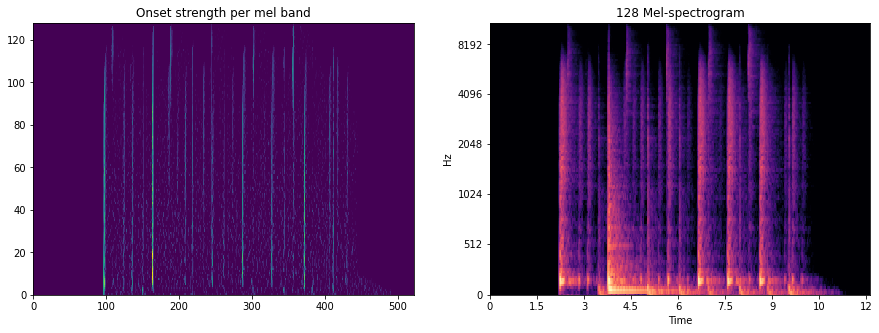

In [42]:
import librosa.display
import matplotlib.pyplot as plt
import librosa.onset as onset
y = example.save_audio(sf_path=sf_path)

n_mels = 128
mel_spec = librosa.feature.melspectrogram(y=y, sr=sr, n_mels=n_mels)
mel_spec_dB = librosa.power_to_db(mel_spec, ref=np.max)

print(mel_spec_dB.shape)
o_strength = np.zeros(mel_spec_dB.shape)

for i in range(n_mels):
    o_strength[i,:] = onset.onset_strength(S=mel_spec_dB[i,:])

fig, ax = plt.subplots(nrows=1, ncols=2, figsize=(15,5))
ax[0].pcolormesh(o_strength)
ax[0].set_title('Onset strength per mel band')
librosa.display.specshow(mel_spec_dB, y_axis='mel',x_axis='time',ax=ax[1])
ax[1].set_title('128 Mel-spectrogram')




## Multi-band onset strength (Constant-Q Transform + Difference)
+ 2018 Cartwright and Bello: Logarithmic power spectrogram is calculated using a 2048-samples window size and a resulting frame rate of 100Hz. The frequency axis is transformed to a logarithmic scale using twelve triangular filters per octave over a frequency range from 20 to 20,000Hz. This results in a total number of 84 frequency bins. 
+ Similar computation described in 2017 Vogt et al: Positive first-order-differential over time of the spectrogram

In [43]:
# https://github.com/mcartwright/dafx2018_adt/blob/master/large_vocab_adt_dafx2018/features.py

import librosa
import scipy.signal
import numpy as np
import resampy
import soundfile as psf

FRAME_INTERVAL = 0.01  # s

def read_audio(filepath, sr=None, mono=True, peak_norm=False):
    """
    Read audio
    Parameters
    ----------
    filepath
    sr
    mono
    Returns
    -------
    y, sr
    """
    try:
        y, _sr = psf.read(filepath)
        y = y.T
    except RuntimeError:
        y, _sr = librosa.load(filepath, mono=False, sr=None)

    if sr is not None and sr != _sr:
        y = resampy.resample(y, _sr, sr, filter='kaiser_fast')
    else:
        sr = _sr

    if mono:
        y = librosa.to_mono(y)

    if peak_norm:
        y /= np.max(np.abs(y))

    return y, sr


def cq_matrix(bins_per_octave, num_bins, f_min, fft_len, sr):
    """
    Compute center frequencies of the log-spaced filterbank
    Parameters
    ----------
    bins_per_octave : int
    num_bins : int
    f_min : float
    fft_len : int
    sr : float
    Returns
    -------
    c_mat
    """
    # note range goes from -1 to bpo*num_oct for boundary issues
    f_cq = f_min * 2 ** ((np.arange(-1, num_bins+1)) / bins_per_octave)         
    # centers in bins
    kc = np.round(f_cq * (fft_len / sr)).astype(int)
    c_mat = np.zeros([num_bins, int(np.round(fft_len / 2))])
    for k in range(1, kc.shape[0]-1):
        l1 = kc[k]-kc[k-1]
        w1 = scipy.signal.triang((l1 * 2) + 1)
        l2 = kc[k+1]-kc[k]                             
        w2 = scipy.signal.triang((l2 * 2) + 1)
        wk = np.hstack([w1[0:l1], w2[l2:]])  # concatenate two halves. l1 and l2 are different because of the log-spacing
        c_mat[k-1, kc[k-1]:(kc[k+1]+1)] = wk / np.sum(wk)  # normalized to unit sum;
    return c_mat        # matrix with triangular filterbank


def onset_detection_fn(x, f_win_size, f_hop_size, f_bins_per_octave, f_octaves, f_fmin, sr, mean_filter_size):
    """
    Filter bank for onset pattern calculation
    """
    # calculate frequency constant-q transform
    f_win = scipy.signal.hanning(f_win_size)
    x_spec = librosa.stft(x,
                          n_fft=f_win_size,
                          hop_length=f_hop_size,
                          win_length=f_win_size,
                          window=f_win)
    x_spec = np.abs(x_spec) / (2 * np.sum(f_win))

    f_cq_mat = cq_matrix(f_bins_per_octave, f_octaves * f_bins_per_octave, f_fmin, f_win_size, sr)
    x_cq_spec = np.dot(f_cq_mat, x_spec[:-1, :])

    # subtract moving mean
    b = np.concatenate([[1], np.ones(mean_filter_size, dtype=float) / -mean_filter_size])       # DIFFERENCE BETWEEN THE CURRENT FRAME AND THE MEAN OF THE PREVIOUS mean_filter_size FRAMES 
    od_fun = scipy.signal.lfilter(b, 1, x_cq_spec, axis=1)                                      

    # half-wave rectify
    od_fun = np.maximum(0, od_fun)

    # post-process OPs
    od_fun = np.log10(1 + 1000*od_fun)                  ## log scaling
    return od_fun, x_cq_spec


def extract_features(audio_file_path, sr=22050, channel=1):
    x, sr = read_audio(audio_file_path, mono=True, sr=sr)

    f_win_size = 1024
    f_hop_size = int(round(FRAME_INTERVAL * sr))
    f_bins_per_octave = 8
    f_octaves = 8
    f_fmin = 40
    mean_filter_size = 22

    # normalize
    x /= np.max(np.abs(x))

    od_fun, x_cq_spec = onset_detection_fn(x,
                                           f_win_size,
                                           f_hop_size,
                                           f_bins_per_octave,
                                           f_octaves,
                                           f_fmin,
                                           sr,
                                           mean_filter_size)

    logf_stft = librosa.power_to_db(x_cq_spec).astype('float32')
    od_fun = np.abs(od_fun).astype('float32')

    # reshape for model
    ms_input_array = np.moveaxis(logf_stft, 1, 0)
    ms_input_array = np.expand_dims(ms_input_array, axis=2)
    os_input_array = np.moveaxis(od_fun, 1, 0)
    os_input_array = np.clip(os_input_array / 2.25, 0, 1)
    os_input_array = np.expand_dims(os_input_array, axis=2)

    return ms_input_array, os_input_array, sr

/Users/pelinski/opt/anaconda3/envs/torch_thesis/lib/python3.6/site-packages/ipykernel_launcher.py:77: DeprecationWarning: `hanning` is deprecated, use `scipy.signal.windows.hann` instead!


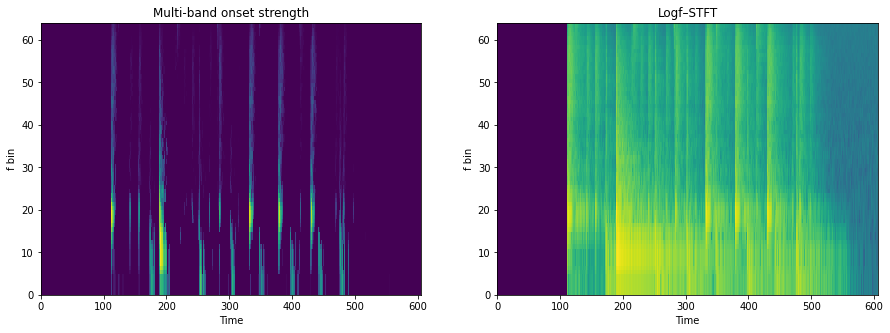

In [44]:
import matplotlib.pyplot as plt
sr=44100
ms_input_array, os_input_array, sr = extract_features("./misc/temp.wav",sr=sr)
ms_input_array = np.squeeze(ms_input_array)
os_input_array = np.squeeze(os_input_array)

fig, ax = plt.subplots(nrows=1, ncols=2, figsize=(15,5))
ax[0].pcolormesh(os_input_array.T)
ax[0].set_xlabel('Time')
ax[0].set_ylabel('f bin')
ax[0].set_title('Multi-band onset strength')
ax[1].set_xlabel('Time')
ax[1].set_ylabel('f bin')
ax[1].set_title('Logf–STFT')
ax[1].pcolormesh(ms_input_array.T)


## NMF
(Hidden features/reduced rows are frequency bins). NMF is based on iteratively computing a low-rank approximation of the spectrogram. The basis functions are called templates and can be interprated as an averaged spectra of the corresponding drum instruments (Wu et a. 2018)

In [4]:
import librosa
import sklearn
import matplotlib.pyplot as plt
import warnings 

warnings.filterwarnings("ignore")       # ignore librosa warnings

sr=44100
sf_path="../hvo_sequence/soundfonts/Standard_Drum_Kit.sf2"
n_fft=2048
hop_length=221              # this was from a paper
win_length=1024
window='hann'
plot=True

# Get STFT
y = example.save_audio(sr=sr,sf_path=sf_path)
sy = librosa.stft(y, n_fft=n_fft, hop_length=hop_length, win_length=win_length, window=window)
stft = np.abs(sy)           # do not transform to db because db are negative
stft = stft/np.max(stft)    # normalize

mel_spec = librosa.feature.melspectrogram(y=y, sr=sr, n_mels=128, fmax=8000)
#mel_spec = librosa.power_to_db(mel_spec, ref=np.max)

# decomposition types (transformer types)
#T = sklearn.decomposition.MiniBatchDictionaryLearning(n_components=9)
#T = sklearn.decomposition.PCA(n_components=9)
T = sklearn.decomposition.NMF(n_components=7)
comps, acts = librosa.decompose.decompose(mel_spec, sort=True, transformer=T)

# plot
binFreq = np.arange(n_fft/2+1)*float(sr)/n_fft   
fig, ax = plt.subplots(nrows=1, ncols=2, figsize=(15,5))
librosa.display.specshow(librosa.amplitude_to_db(comps,ref=np.max), y_axis='log', ax=ax[0])
ax[0].set(title='Components')
librosa.display.specshow(acts, x_axis='time', ax=ax[1])
ax[1].set(ylabel='Components', title='Activations')

TypeError: Dimensions of C (128, 7) are incompatible with X (8) and/or Y (1025); see help(pcolormesh)

### Extra: Multi-band onset strength ---> NMF

[Text(0, 0.5, 'Components'), Text(0.5, 1.0, 'Activations')]

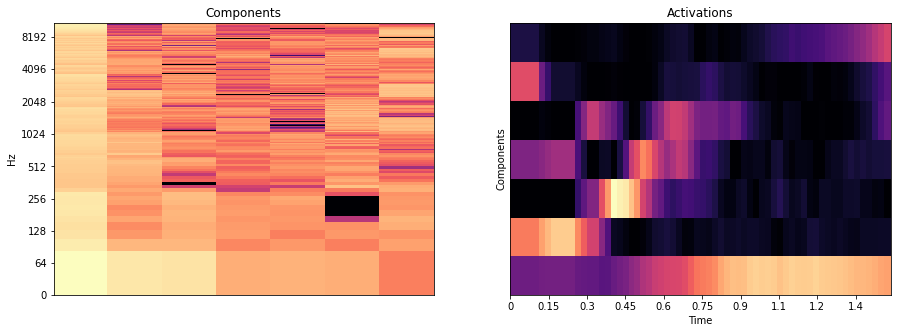

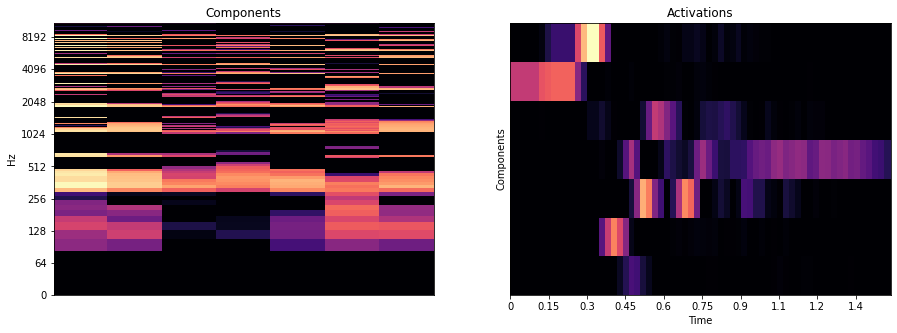

In [28]:
T = sklearn.decomposition.NMF(n_components=7)
comps, acts = librosa.decompose.decompose(np.abs(0.5*ms_input_array + 0.5*os_input_array), sort=True, transformer=T)

# plot
#binFreq = np.arange(n_fft/2+1)*float(sr)/n_fft   
fig, ax = plt.subplots(nrows=1, ncols=2, figsize=(15,5))
librosa.display.specshow(librosa.amplitude_to_db(comps,ref=np.max), y_axis='log', ax=ax[0])
ax[0].set(title='Components')
librosa.display.specshow(acts, x_axis='time', ax=ax[1])
ax[1].set(ylabel='Components', title='Activations')

comps, acts = librosa.decompose.decompose(os_input_array, sort=True, transformer=T)
fig, ax = plt.subplots(nrows=1, ncols=2, figsize=(15,5))
librosa.display.specshow(librosa.amplitude_to_db(comps,ref=np.max), y_axis='log', ax=ax[0])
ax[0].set(title='Components')
librosa.display.specshow(acts, x_axis='time', ax=ax[1])
ax[1].set(ylabel='Components', title='Activations')

## MFCCs and Mel-spectrograms
Mel-frequency spectrogram is computed by passing the STFT spectrogram through a filterbank of triangular filers centered in the mel frequencies. However the resulting coefficients are highly correlated and can be reduced in dimension by applying a Discrete Cosine Transform (DCT) to obtain MFCCs.

(12, 396) (128, 396)


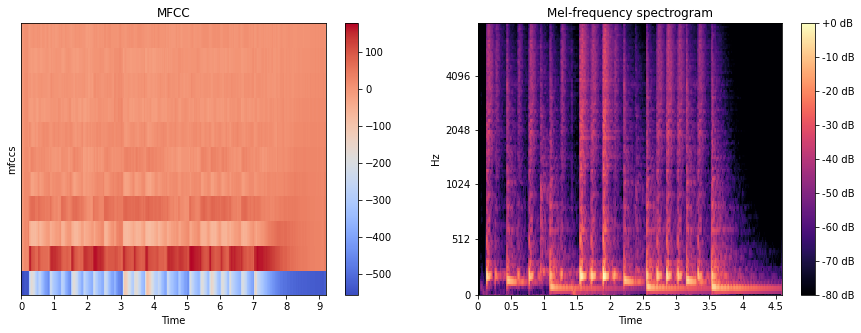

In [20]:
import matplotlib.pyplot as plt

sr = 44100
y = example.save_audio(sr=sr,sf_path=sf_path)

fig, ax = plt.subplots(1,2, figsize=(15,5))

# mfccs
mfccs = librosa.feature.mfcc(y=y, sr=sr, n_mfcc=12)
img = librosa.display.specshow(mfccs, x_axis='time', ax=ax[0], y_coords=np.arange(mfccs.shape[0]))
ax[0].set_ylabel('mfccs')
fig.colorbar(img, ax=ax[0])
ax[0].set(title='MFCC')

# mel spectrogram
mel_spec = librosa.feature.melspectrogram(y=y, sr=sr, n_mels=128, fmax=8000)
mel_spec = librosa.power_to_db(mel_spec, ref=np.max)
img = librosa.display.specshow(mel_spec, x_axis='time', y_axis='mel', sr=sr, fmax=8000, ax=ax[1])
fig.colorbar(img, ax=ax[1], format='%+2.0f dB')
ax[1].set(title='Mel-frequency spectrogram')

# compare shapes
print(mfccs.shape, mel_spec.shape)

### * Helpers

In [ ]:
print(stft.shape)
numFrames = int(stft[0,:].size)
frmTime = hop_length*np.arange(numFrames)/float(sr); 
binFreq = np.arange(n_fft/2+1)*float(sr)/n_fft   
#plt.pcolormesh(frmTime, binFreq, librosa.amplitude_to_db(stft, ref=np.max))